In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
class LinearRegression:
  def __init__(self):
    self.theta = np.zeros((2,1)) # theta[0] -b & theta[1] - w
    self.line_eqn = [] #hold the diff values of thetas.

  def fit(self,X,y,alpha,epochs,**kwargs):
      """
      Take in numpy array X, y and theta and update theta by taking   num_iters gradient steps
      with learning rate of alpha
      
      return theta and the list of the cost of theta during each  iteration
      """
      
      m=len(y)
      J_history=[]

      for i in range(epochs):
          # print(self.theta)
          self.line_eqn.append(np.copy(self.theta))
          predictions = X.dot(self.theta)
          error = np.dot(X.transpose(),(predictions -y))
          descent=alpha * 1/m * error
          self.theta-=descent
          J_history.append(self.computeCost(X,y,self.theta))

      return self.theta, J_history

  def computeCost(self,X,y,theta):
      """
      Take in a numpy array X,y, theta and generate the cost function of using theta(w) as parameter in a linear regression model
      """
      m=len(y)
      predictions=X.dot(theta)  #y = wx+b
      # print(predictions) 
      square_err=(predictions - y)**2   #f(x(i))-y(i)
      # print(np.isfinite(square_err))
      # print(square_err) 
      cost = 1/(2*m) * np.sum(square_err)
      return cost

In [ ]:
df = pd.read_csv("/content/train (1).csv")

In [ ]:
X = df.iloc[:,3]

In [ ]:
y = df.iloc[:,-1]

In [ ]:
X,y

(0       65.0
 1       80.0
 2       68.0
 3       60.0
 4       84.0
         ... 
 1455    62.0
 1456    85.0
 1457    66.0
 1458    68.0
 1459    75.0
 Name: LotFrontage, Length: 1460, dtype: float64,
 0       208500
 1       181500
 2       223500
 3       140000
 4       250000
          ...  
 1455    175000
 1456    210000
 1457    266500
 1458    142125
 1459    147500
 Name: SalePrice, Length: 1460, dtype: int64)

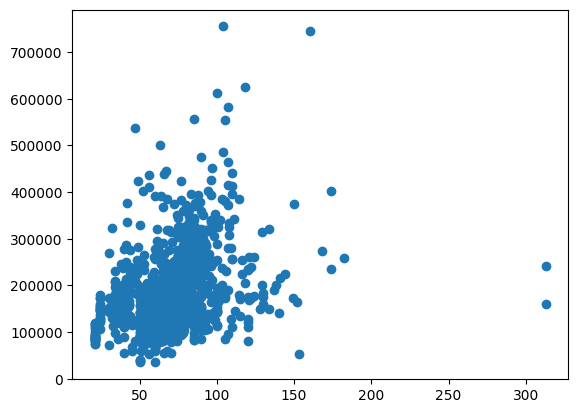

In [ ]:
plt.scatter(X,y)

In [ ]:
X = X.values.reshape(len(X),1)
y = y.values.reshape(len(y),1)

In [ ]:
nan_indices = np.isnan(X).any(axis=1)

In [ ]:
# Remove rows with NaN values from X and y
X_clean = X[~nan_indices]
y_clean = y[~nan_indices]

In [ ]:
X_clean.shape, y_clean.shape

((1201, 1), (1201, 1))

In [ ]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()

In [ ]:
# Fit and transform the non-bias columns of X
X_clean = sc.fit_transform(X_clean)

In [ ]:
#transform y
y_clean = sc.transform(y_clean)

In [ ]:
X_clean=np.append(np.ones((len(X_clean),1)),X_clean[:,0].reshape(len(X_clean),1),axis=1)

In [ ]:
model = LinearRegression()

In [ ]:
theta,history = model.fit(X_clean,y_clean,alpha=0.01,epochs=1000)

In [ ]:
history[-1]

5165916.7342972355

In [ ]:
theta

array([[7443.6792275 ],
       [1207.96339767]])

In [ ]:
model.theta

array([[7443.6792275 ],
       [1207.96339767]])

In [ ]:
model.line_eqn

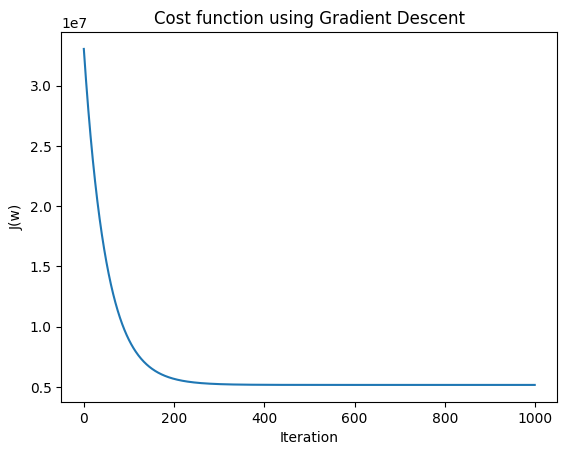

In [ ]:
plt.plot(history)
plt.xlabel("Iteration")
plt.ylabel("J(w)")
plt.title("Cost function using Gradient Descent")
plt.show()

In [ ]:
X_clean,y_clean

(array([[ 1.        , -0.20803433],
        [ 1.        ,  0.40989452],
        [ 1.        , -0.08444856],
        ...,
        [ 1.        , -0.16683907],
        [ 1.        , -0.08444856],
        [ 1.        ,  0.20391824]]),
 array([[ 8586.3252672 ],
        [ 7474.05334002],
        [ 9204.25411563],
        ...,
        [10975.6501478 ],
        [ 5851.99011288],
        [ 6073.41461691]]))

In [ ]:
x_test = [np.array([x[1]]) for x in X_clean]
y_pred =[y*model.theta[1]+model.theta[0] for y in x_test]

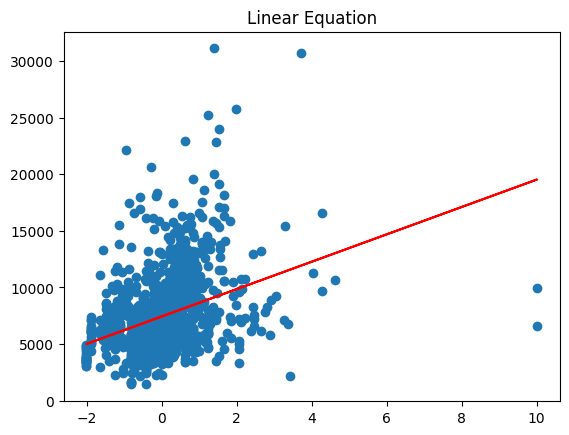

In [ ]:
plt.scatter(X_clean[:,1:],y_clean) # X_clean[:,1:] - avoiding the bias term
plt.plot(x_test,y_pred,color="r")
plt.title("Linear Equation")
plt.show()

In [ ]:
x_test_original_scale = sc.inverse_transform(x_test)
y_pred_original_scale = sc.inverse_transform(y_pred)

In [ ]:
fn = "f(x) ="+str(round(model.theta[0,0],2))+" + "+str(round(model.theta[1,0],2))+"x1"

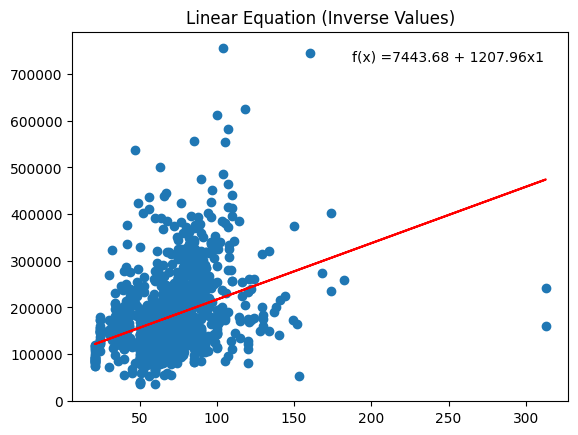

In [ ]:
plt.scatter(df.iloc[:,3],df.iloc[:,-1])
plt.plot(x_test_original_scale,y_pred_original_scale,color="r")
plt.title("Linear Equation (Inverse Values)")
x_pos = 0.5  # X-coordinate position of the equation text
y_pos = 50  # Y-coordinate position of the equation text
plt.text(0.95, 0.95, fn, fontsize=10, color='black', ha='right', va='top', transform=plt.gca().transAxes, bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'))
plt.show()

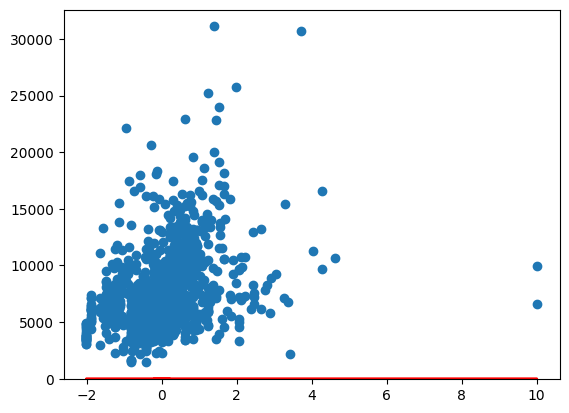

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation


# Create a figure and axis for the plot
fig, ax = plt.subplots()

# Create a scatter plot
scatter = ax.scatter(X_clean[:,1:],y_clean)

# Initialize an empty line
line, = ax.plot([], [], color='red')


def update(frame):
    # Get the current theta value
    theta = model.line_eqn[frame]
    # Generate predicted y values using the current theta
    y_pred = np.dot(X_clean[:,1:], theta[1]) + theta[0]
    # Get the equation of the line
    # equation = "y = " + str(theta[0]) + " + " + str(theta[1]) + "x"

    # # Add the equation to the plot
    # ax.text(0.95, 0.05, equation, ha="right", va="top", transform=ax.transAxes)
    # Update the line with the new data
    line.set_data(x_test, y_pred)

    return line,

# Create the animation
animation = FuncAnimation(fig, update, frames=len(model.line_eqn), interval=50,blit=True)

anim = animation

# Show the plot
plt.show()

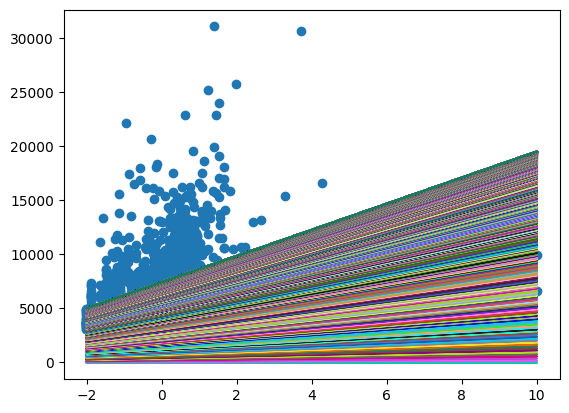

In [ ]:
plt.scatter(X_clean[:,1:],y_clean)

for theta in model.line_eqn:
  color = np.random.rand(3,)
  y_pred = np.dot(X_clean[:,1:], theta[1]) + theta[0]
  plt.plot(x_test,y_pred,color=color)

plt.show()

In [ ]:
from matplotlib import rc
rc('animation', html='jshtml')

In [ ]:
animation

In [ ]:
animation.save("/content/animation.mp4")

In [ ]:
import ipywidgets as widgets
from IPython.display import display

# Path to the video file
video_path = "/content/animation.mp4"

# Create a Video widget
video_widget = widgets.Video.from_file(video_path)

# Display the widget
display(video_widget)

Video(value=b'\x00\x00\x00 ftypisom\x00\x00\x02\x00isomiso2avc1mp41\x00\x00\x00\x08free\x00\x03\xbf7mdat\x00\x…

## Linear Regression in Multiple Variable

In [2]:
import numpy as np
import pandas as pd

In [31]:
class LinearRegression:
  def __init__(self):
    # self.theta = np.zeros((2,1)) # theta[0] -b & theta[1] - w
    self.line_eqn = [] #hold the diff values of thetas.

  def fit(self,X,y,alpha,epochs,**kwargs):
      """
      Take in numpy array X, y and theta and update theta by taking   num_iters gradient steps
      with learning rate of alpha
      
      return theta and the list of the cost of theta during each  iteration
      """
      
      m=len(y)
      J_history=[]
      self.theta = np.zeros((X.shape[1],1)) 
      self.b = 0
      y = y.reshape(-1,1)

      for i in range(epochs):
          # print(self.theta)
          self.line_eqn.append(np.copy(self.theta))
          predictions = X.dot(self.theta) + self.b
          print(X.transpose().shape)
          print(predictions.shape)
          error = np.dot(X.transpose(),(predictions -y))
          print(error.shape)
          descent=alpha * 1/m * error
          self.theta-=descent
          self.b = self.b - alpha * 1/m * np.sum(predictions -y)
          J_history.append(self.computeCost(X,y,self.theta,self.b))

      return self.theta, J_history

  def computeCost(self,X,y,w,b):
      """
      Take in a numpy array X,y, w,b and generate the cost function of using theta(w) as parameter in a linear regression model
      """
      m=len(y)
      predictions=X.dot(w) + b  #y = w.x+b
      square_err=(predictions - y)**2   #f(x(i))-y(i)
      cost = 1/(2*m) * np.sum(square_err)
      return cost

  @property
  def line(self):
    return self.theta

  def predict(self,x):
    """
    x - input features
    """
    prediction = x.dot(self.theta) + self.b
    return prediction

In [3]:
from sklearn.datasets import make_regression

# Generate a dummy regression dataset
X, y = make_regression(n_samples=100, n_features=2, noise=0.1, random_state=42)

# Print the shape of the dataset
print("X shape:", X.shape)
print("y shape:", y.shape)

X shape: (100, 2)
y shape: (100,)


In [32]:
lr = LinearRegression()

In [33]:
lr.fit(X,y,0.01,1000)

(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)
(2, 100)
(100, 1)
(2, 1)


(array([[87.65361607],
        [74.0811215 ]]),
 [5608.7388025352475,
  5509.400741484314,
  5411.863212294944,
  5316.092953252153,
  5222.057326421292,
  5129.724305813618,
  5039.062465778333,
  4950.040969616748,
  4862.629558414301,
  4776.798540086208,
  4692.51877863267,
  4609.761683599561,
  4528.499199740684,
  4448.703796877661,
  4370.348459953721,
  4293.406679277585,
  4217.852440953841,
  4143.660217496197,
  4070.804958620089,
  3999.262082211214,
  3929.0074654665827,
  3860.0174362047896,
  3792.2687643422314,
  3725.738653532092,
  3660.4047329629643,
  3596.245049314034,
  3533.238058863818,
  3471.362619749505,
  3410.5979843740065,
  3350.923791957878,
  3292.3200612333167,
  3234.7671832775245,
  3178.2459144827403,
  3122.737369660333,
  3068.2230152763536,
  3014.68466281606,
  2962.1044622748996,
  2910.4648957735435,
  2859.748771294586,
  2809.939216538567,
  2761.019672897039,
  2712.9738895404157,
  2665.785917618412,
  2619.440104570914,
  2573.9210885471

In [34]:
lr.line

array([[87.65361607],
       [74.0811215 ]])

In [37]:
lr.predict(X[2,:])

array([213.68970711])

In [39]:
y[2]

213.72608292020408